In [1]:
import torch
import numpy as np
from sklearn.metrics import precision_score, recall_score
import matplotlib.pyplot as plt
import time

In [2]:
import torch.nn as nn
from torch.utils.data import DataLoader, TensorDataset, random_split

### <b>1. Build many-to-many RNN</b>

In [80]:
class RNN(nn.Module):
    def __init__(self, input_size, hidden_size, output_size=1):
        """
        Args:
            input_size: number of input features
            hidden_size: number of hidden units
            output_size: number of output features (default: 1, which class it belongs to)
        """
        super(RNN, self).__init__()
        
        self.hidden_size = hidden_size
        
        # Input to hidden layer
        self.input_to_hidden = nn.Linear(input_size, hidden_size)
        
        # Hidden to hidden layer (recurrent connection)
        self.hidden_to_hidden = nn.Linear(hidden_size, hidden_size)
        
        # Hidden to output layer
        self.hidden_to_output = nn.Linear(hidden_size, output_size)
        
        # Activation functions
        self.sigmoid = nn.Sigmoid()
        self.tanh    = nn.Tanh()

    def forward(self, x, h_t=None):
        """
        Args:
            x: input tensor of shape (batch_size, input_size)
        
        Returns:
            output: output tensor of shape (batch_size, 1)

        Recursively calculate the hidden layer:
            h: input/updated hidden state tensor of shape (batch_size, hidden_size)
        """
        batch_size, seq_length, input_size = x.size()

        outputs = []
        
        if h_t is None:
            h_t = torch.zeros(batch_size, self.hidden_size, device=x.device)

        for t in range(seq_length):
            x_t = x[:, t, :]

            # Debug shapes
            i2h = self.input_to_hidden(x_t)
            h2h = self.hidden_to_hidden(h_t)
            print(f"input_to_hidden output: {i2h.shape}")
            print(f"hidden_to_hidden output: {h2h.shape}")
            # update hidden layer
            h_t = self.tanh(i2h + h2h)
            # compute output layer
            output_t = self.sigmoid(self.hidden_to_output(h_t))
            
            outputs.append(output_t.unsqueeze(1))
        
        output = torch.cat(outputs, dim=1) # （batch_size, seq_length）

        return output, h_t


### <b>2. Train RNN model</b>

In [85]:
class Trainer:
    def __init__(self, model, optimizer, train_loader, test_loader, criterion, device):
        self.model = model
        self.optimizer = optimizer
        self.train_loader = train_loader
        self.test_loader = test_loader
        self.criterion = criterion
        self.device = device

    def train(self, num_epochs):
        self.model.to(self.device)

        self.model.train()
        train_losses = []
        test_losses = []

        train_precisions = []
        train_recalls = []
        test_precisions = []
        test_recalls = []

        # Start overall training timer
        training_start_time = time.time()

        # initialize h_t
        h_t = None

        for epoch in range(num_epochs):
            epoch_start_time = time.time()

            # Training phase
            # print(f"Starting Epoch {epoch+1}/{num_epochs}...")

            epoch_train_loss = 0.0
            current_loss     = epoch_train_loss
            prediction_epoch = []
            target_epoch     = []

            for inputs, targets in self.train_loader:
                inputs, targets = inputs.to(self.device), targets.to(self.device)

                self.optimizer.zero_grad()
                # detach
                if h_t is None:
                    h_t = torch.zeros(inputs.size(0), self.model.hidden_size).to(self.device)
                else:
                    h_t = h_t.detach()
                    
                # recursively update hidden state weights
                outputs, h_t  = self.model(inputs, h_t)
                print(f"hidden_to_hidden: {model.hidden_to_hidden.weight.shape}")
                predictions = (outputs >= 0.5).float()
                # precition & target
                prediction_epoch.append(predictions.cpu().detach())
                target_epoch.append(targets.cpu().detach())
                # loss & backpropagation
                loss = self.criterion(outputs.squeeze(), targets.float())
                loss.backward()
                self.optimizer.step()
                epoch_train_loss += loss.item() * inputs.size(0)

            # precision and recall concatenate all batch
            prediction_epoch = torch.cat(prediction_epoch).numpy().flatten()
            target_epoch     = torch.cat(target_epoch).numpy().flatten()
            train_precision  = precision_score(target_epoch, prediction_epoch, average=None, zero_division=0)
            train_recall     = recall_score(target_epoch, prediction_epoch, average=None, zero_division=0)

            # loss combined all batch (update epoch_train_loss)
            epoch_train_loss /= len(self.train_loader.dataset)
            train_losses.append(epoch_train_loss)

            # Evaluation on test set
            # print("Evaluating on test set...")
            self.model.eval()
            epoch_test_loss = 0.0
            # clear again
            prediction_epoch = []
            target_epoch     = []
            with torch.no_grad():
                for inputs, targets in self.test_loader:
                    inputs, targets = inputs.to(self.device), targets.to(self.device)
                    outputs, _ = self.model(inputs, h_t)
                    
                    # Debug shapes
                    # print(f"Outputs shape: {outputs.shape}")
                    # print(f"Targets shape: {targets.shape}")

                    loss = self.criterion(outputs.squeeze(), targets.float())
                    epoch_test_loss += loss.item() * inputs.size(0)

                    # precition & target
                    predictions = (outputs >= 0.5).float()
                    prediction_epoch.append(predictions.cpu().detach())
                    target_epoch.append(targets.cpu().detach())

            # precision and recall concatenate all batch
            prediction_epoch = torch.cat(prediction_epoch).numpy().flatten()
            target_epoch     = torch.cat(target_epoch).numpy().flatten()
            # print(f"Epoch {epoch+1} - Prediction Epoch Shape: {prediction_epoch.shape}")
            # print(f"Epoch {epoch+1} - Target Epoch Shape: {target_epoch.shape}")
            test_precision   = precision_score(target_epoch, prediction_epoch, average=None, zero_division=0)
            test_recall      = recall_score(target_epoch, prediction_epoch, average=None, zero_division=0)

            # loss combined all batch
            epoch_test_loss /= len(self.test_loader.dataset)
            test_losses.append(epoch_test_loss)

            # Calculate elapsed time
            epoch_time = time.time() - epoch_start_time
            total_time = time.time() - training_start_time

            # print time, loss, precision, recall
            print(f'Epoch [{epoch+1}/{num_epochs}] completed in {epoch_time:.2f}s (Total: {total_time:.2f}s)')
            print(f'Train Loss: {epoch_train_loss:.4f}, Test Loss: {epoch_test_loss:.4f}')

            # test for convergence
            delta_loss = abs(current_loss - epoch_train_loss)
            if delta_loss < 1e-6:
                print(f"Convergence reached at epoch {epoch+1}. Stopping training.")
                break


        return (train_losses, test_losses), (train_precision, test_precision), (train_recall, test_recall)


### <b>3. Apply RNN</b>

In [5]:
# load data
data = np.load("phaselink.npz")
X = data["X"]   # (100000, np, 5),where np is a sliding window length (length of a subsequence)
# 5 dimensions are lat, lon, time, type, zero padding
Y = data["Y"]   # the first pick of the sequence

Text(0.5, 0.98, 'yellow: S-wave, purple: P-wave')

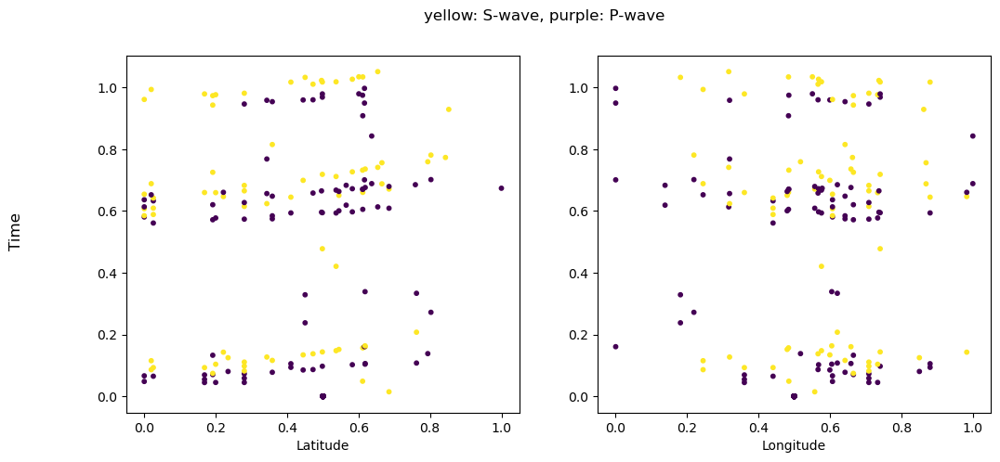

In [6]:
#  plot some seq
ind1   = 5300  # plot the kth sequence
ind2   = ind1+1

lat = X[ind1:ind2, :, 0].flatten()
lon = X[ind1:ind2, :, 1].flatten()
time  = X[ind1:ind2, :, 2].flatten()
type_ = X[ind1:ind2, :, 3].flatten()

fig, axes = plt.subplots(1, 2, figsize=(12, 5))
scatter0 = axes[0].scatter(lat, time, c=type_, label='Latitude', s=10)
scatter1 = axes[1].scatter(lon, time, c=type_, label='Longitude', s=10)

# label
axes[0].set_xlabel('Latitude')
axes[1].set_xlabel('Longitude')
fig.supylabel('Time')
fig.suptitle('yellow: S-wave, purple: P-wave')

In [7]:
# check the distribution of labels: aggregating predictions
n_picks, len_subseq = Y.shape

event_labels  = np.zeros((n_picks + len_subseq, ), dtype=int) * np.nan
current_event = int(1)

n_nuc   = 8
n_merge = n_nuc - 1

# lopo over all sequences
for i in range(n_picks):
    # index of picks that are the same as root pick
    # real indices = i+indices_same_root
    indices_same_root = np.where(Y[i, :] == 1)[0]

    # get the subsequence with all picks that share the same root pick
    subseq_labels = event_labels[i + indices_same_root]
    print(f'Subsequence labels for pick {i}: {subseq_labels}')

    # obtain the most frequent existing label in the subseq_labels
    if np.any(~np.isnan(subseq_labels)):
        unique, counts = np.unique(subseq_labels[~np.isnan(subseq_labels)], return_counts=True)
        most_frequent_label = unique[np.argmax(counts)]
        print(f'Most frequent label in subsequence: {most_frequent_label}')

        # assign the most frequent label to all picks that share the same root pick
        event_labels[i + indices_same_root] = most_frequent_label
        # also update other labels with the most frequent label
        for label in unique:
            if label != most_frequent_label:
                event_labels[event_labels == label] = most_frequent_label
        continue

    else:
        # assign new label
        event_labels[i + indices_same_root] = current_event
        current_event += 1
    
    # updated subsquece labels
    subseq_labels = event_labels[i + indices_same_root]
    print(f'Updated subsequence labels for pick {i}: {subseq_labels}')

# set back
current_event = 1

# eliminate events that have picks less than n_nuc
event_counts = np.bincount(event_labels[~np.isnan(event_labels)].astype(int))
print(event_labels)
for event_label, count in enumerate(event_counts):
    if count < n_nuc:
        event_labels[event_labels == event_label] = np.nan
n_events = len(np.unique(event_labels[~np.isnan(event_labels)]))
print(f'Number of unique events: {n_events}')

Subsequence labels for pick 0: [nan nan nan nan]
Updated subsequence labels for pick 0: [1. 1. 1. 1.]
Subsequence labels for pick 1: [1.]
Most frequent label in subsequence: 1.0
Subsequence labels for pick 2: [nan nan  1.  1. nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
Most frequent label in subsequence: 1.0
Subsequence labels for pick 3: [ 1.  1.  1.  1.  1. nan  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.]
Most frequent label in subsequence: 1.0
Subsequence labels for pick 4: [1.]
Most frequent label in subsequence: 1.0
Subsequence labels for pick 5: [ 1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.
  1. nan nan  1. nan nan nan nan nan nan nan nan]
Most frequent label in subsequence: 1.0
Subsequence labels for pick 6: [1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1.]
Most frequent label in subsequence: 1.0
Subsequence labels 

In [82]:
# split dataset into train and test sets, 80% and 20%, each unit is a sequence
batch_size = 256

X_tensor = torch.tensor(X, dtype=torch.float32)
Y_tensor = torch.tensor(Y, dtype=torch.float32)
dataset = TensorDataset(X_tensor, Y_tensor)
train_size = int(0.8 * n_picks)
test_size  = n_picks - train_size
train_dataset, test_dataset = random_split(dataset, [train_size, test_size])
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_loader  = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)


In [83]:
# define model, optimizer, loss function
input_size  = X.shape[2]  # number of features
hidden_size = 16
model       = RNN(input_size, hidden_size)
# use SGD optimizer
optimizer   = torch.optim.SGD(model.parameters(), lr=0.01, momentum=0.9)
criterion   = nn.BCELoss()
device      = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [86]:
# just a try (to make sure things work)
# trainer
trainer = Trainer(model, optimizer, train_loader, test_loader, criterion, device)
# train
num_epochs = 2
(train_losses, test_losses), (train_precisions, test_precisions), (train_recalls, test_recalls) = trainer.train(num_epochs)

input_to_hidden output: torch.Size([256, 16])
hidden_to_hidden output: torch.Size([256, 16])
input_to_hidden output: torch.Size([256, 16])
hidden_to_hidden output: torch.Size([256, 16])
input_to_hidden output: torch.Size([256, 16])
hidden_to_hidden output: torch.Size([256, 16])
input_to_hidden output: torch.Size([256, 16])
hidden_to_hidden output: torch.Size([256, 16])
input_to_hidden output: torch.Size([256, 16])
hidden_to_hidden output: torch.Size([256, 16])
input_to_hidden output: torch.Size([256, 16])
hidden_to_hidden output: torch.Size([256, 16])
input_to_hidden output: torch.Size([256, 16])
hidden_to_hidden output: torch.Size([256, 16])
input_to_hidden output: torch.Size([256, 16])
hidden_to_hidden output: torch.Size([256, 16])
input_to_hidden output: torch.Size([256, 16])
hidden_to_hidden output: torch.Size([256, 16])
input_to_hidden output: torch.Size([256, 16])
hidden_to_hidden output: torch.Size([256, 16])
input_to_hidden output: torch.Size([256, 16])
hidden_to_hidden output:

RuntimeError: The size of tensor a (128) must match the size of tensor b (256) at non-singleton dimension 0

In [52]:
# try learning rate of 1, 0.1, 0.01, 0.001, 0.0001, n_epochs=50
lrs = [1, 0.1, 0.01, 0.001, 0.0001]
new_epochs = 50

train_losses_all = {}
test_losses_all  = {}
train_precisions_all = {}
test_precisions_all  = {}
train_recalls_all = {}
test_recalls_all  = {}

for lr in lrs:
    print(f'Training with learning rate: {lr}')
    optimizer = torch.optim.Adam(model.parameters(), lr=lr)
    trainer = Trainer(model, optimizer, train_loader, test_loader, criterion, device)
    (train_losses, test_losses), (train_precisions, test_precisions), (train_recalls, test_recalls) = trainer.train(num_epochs=new_epochs)
    # store each result
    train_losses_all[lr] = train_losses
    test_losses_all[lr]  = test_losses
    train_precisions_all[lr] = train_precisions
    test_precisions_all[lr]  = test_precisions
    train_recalls_all[lr] = train_recalls
    test_recalls_all[lr]  = test_recalls


Training with learning rate: 1
Epoch [1/50] completed in 87.45s (Total: 87.45s)
Train Loss: 2.5951, Test Loss: 2.6458
Epoch [2/50] completed in 87.18s (Total: 174.63s)
Train Loss: 2.6672, Test Loss: 2.6458
Epoch [3/50] completed in 88.40s (Total: 263.03s)
Train Loss: 2.6672, Test Loss: 2.6458
Epoch [4/50] completed in 96.63s (Total: 359.66s)
Train Loss: 2.6672, Test Loss: 2.6458
Epoch [5/50] completed in 92.63s (Total: 452.29s)
Train Loss: 2.6672, Test Loss: 2.6458
Epoch [6/50] completed in 92.26s (Total: 544.55s)
Train Loss: 2.6672, Test Loss: 2.6458
Epoch [7/50] completed in 112.15s (Total: 656.70s)
Train Loss: 2.6672, Test Loss: 2.6458


KeyboardInterrupt: 

Plotting results for learning rate: 0.1
Plotting results for learning rate: 0.0001


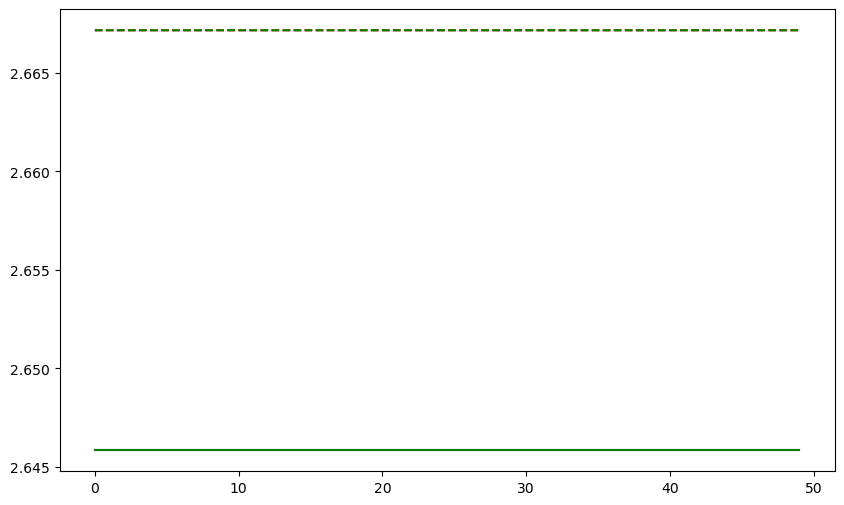

In [ ]:
# plot loss
lrs = [.1, 0.0001]
colors = ['r', 'g', 'b', 'c', 'm']
fig, ax = plt.subplots(figsize=(10, 6))
for c, lr in zip(colors, lrs):
    print(f'Plotting results for learning rate: {lr}')
    ax.plot(train_losses_all[lr], label=f'Train Loss (lr={lr})', linestyle='--', color=c)
    ax.plot(test_losses_all[lr], label=f'Test Loss (lr={lr})', linestyle='-', color=c)


In [73]:
torch.zeros(batch_size, hidden_size, device=device).shape

torch.Size([256, 16])